In [ ]:
!pip install scikit-image opencv-python pywavelets tensorflow


              Method       PSNR      SSIM       MSE
0      Median Filter  26.481162  0.642613  0.002248
1  Wavelet Denoising  26.520535  0.687370  0.002228


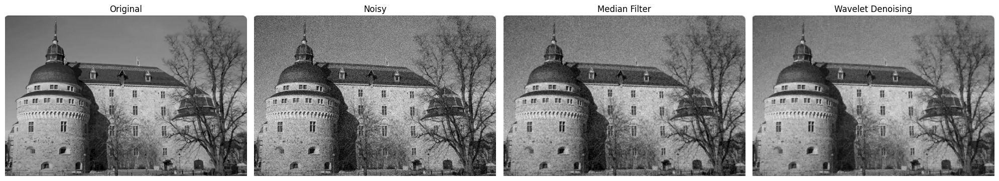

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_float
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim, mean_squared_error as mse
from skimage.restoration import denoise_wavelet
from skimage.util import random_noise
import pandas as pd

image_path = '/content/denoise1.png'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
image = img_as_float(image)

# ==== Add Gaussian noise ====
noisy_image = random_noise(image, mode='gaussian', var=0.01)

# ==== Apply Denoising Techniques ====
# 1. Median Filter
median_denoised = cv2.medianBlur((noisy_image * 255).astype(np.uint8), 3) / 255.0

# 2. Wavelet Denoising
wavelet_denoised = denoise_wavelet(noisy_image, channel_axis=None, rescale_sigma=True)

# ==== Evaluation Metrics ====
def evaluate(original, denoised, name):
    return {
        "Method": name,
        "PSNR": psnr(original, denoised, data_range=1.0),
        "SSIM": ssim(original, denoised, data_range=1.0),
        "MSE": mse(original, denoised)
    }

results = [
    evaluate(image, median_denoised, "Median Filter"),
    evaluate(image, wavelet_denoised, "Wavelet Denoising")
]

# ==== Show Metric Table ====
df = pd.DataFrame(results)
print(df)

# ==== Show Images ====
def show_images(imgs, titles):
    plt.figure(figsize=(20, 4))
    for i, (img, title) in enumerate(zip(imgs, titles)):
        plt.subplot(1, len(imgs), i + 1)
        plt.imshow(img, cmap='gray')
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

show_images(
    [image, noisy_image, median_denoised, wavelet_denoised],
    ['Original', 'Noisy', 'Median Filter', 'Wavelet Denoising']
)


In [ ]:
!pip install opencv-python numpy


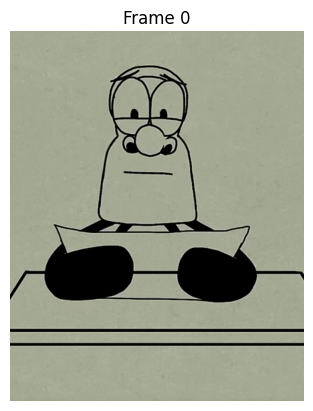

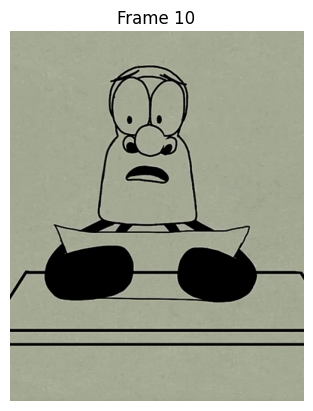

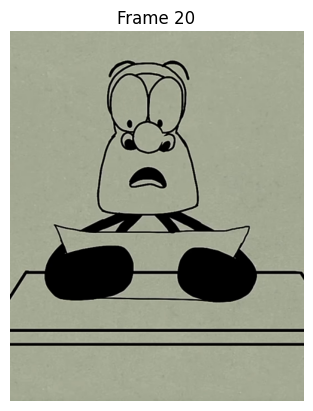

Extracted 28 frames.


In [12]:
import cv2
import os
import matplotlib.pyplot as plt

# Step 1: Load the video
video_path = '/content/Screen Recording 2025-05-02 194507.mp4'  # Replace with your actual path
output_folder = 'extracted_frames'

# Step 2: Create output directory if not exists
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Step 3: Initialize video capture
cap = cv2.VideoCapture(video_path)

# Step 4: Read and save frames
frame_num = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    frame_path = os.path.join(output_folder, f'frame_{frame_num:04d}.jpg')
    cv2.imwrite(frame_path, frame)

    # OPTIONAL: Display some frames (e.g., every 30th)
    if frame_num % 10 == 0:
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.title(f'Frame {frame_num}')
        plt.axis('off')
        plt.show()

    frame_num += 1

cap.release()
cv2.destroyAllWindows()
print(f"Extracted {frame_num} frames.")


In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# === CONFIG ===
video_path = '/content/Screen Recording 2025-05-02 194507.mp4'
output_dir = 'processed_frames'
os.makedirs(output_dir, exist_ok=True)

# === Initialize Video ===
cap = cv2.VideoCapture(video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# === Video Writers for Output Videos ===
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_thresh = cv2.VideoWriter('adaptive_threshold.mp4', fourcc, fps, (w, h), isColor=False)
out_blur = cv2.VideoWriter('gaussian_blur.mp4', fourcc, fps, (w, h), isColor=True)
out_canny = cv2.VideoWriter('canny_edges.mp4', fourcc, fps, (w, h), isColor=False)
out_not = cv2.VideoWriter('bitwise_not.mp4', fourcc, fps, (w, h), isColor=True)

# === Process Frames ===
collage_frames = []
frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Adaptive Thresholding
    th = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                               cv2.THRESH_BINARY, 11, 2)

    # Gaussian Blur
    blur = cv2.GaussianBlur(frame, (9, 9), 0)

    # Canny Edges
    edges = cv2.Canny(gray, 100, 200)

    # Bitwise NOT
    bitwise = cv2.bitwise_not(frame)

    # Write frames to video
    out_thresh.write(th)
    out_blur.write(blur)
    out_canny.write(edges)
    out_not.write(bitwise)

    # Save some frames for collage
    if frame_count % 5 == 0 and len(collage_frames) < 9:
        collage_frames.append(cv2.resize(bitwise, (160, 120)))

    frame_count += 1

cap.release()
out_thresh.release()
out_blur.release()
out_canny.release()
out_not.release()

print("Videos saved.")

# === Make a Collage ===
if collage_frames:
    rows = []
    for i in range(0, len(collage_frames), 3):
        row = np.hstack(collage_frames[i:i+3])
        rows.append(row)
    collage = np.vstack(rows)
    cv2.imwrite('video_collage.jpg', collage)
    plt.imshow(cv2.cvtColor(collage, cv2.COLOR_BGR2RGB))
    plt.title("Video Frame Collage")
    plt.axis('off')
    plt.show()


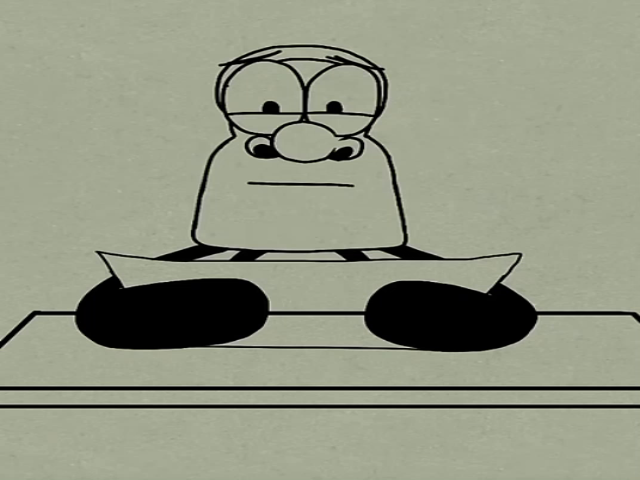

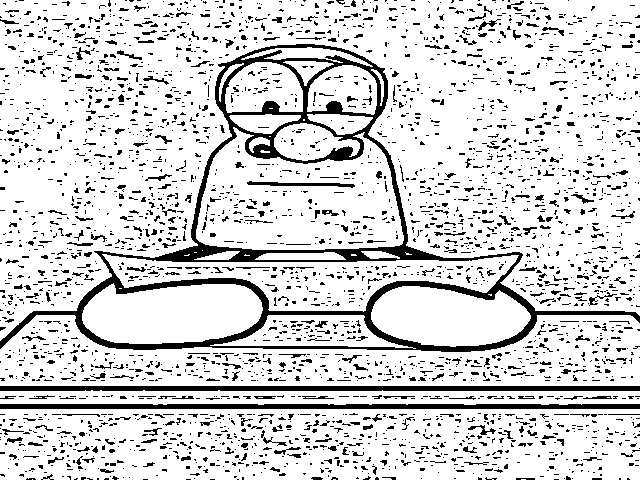

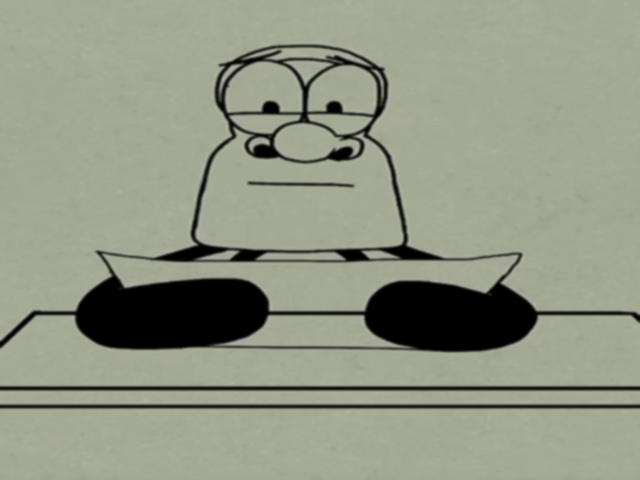

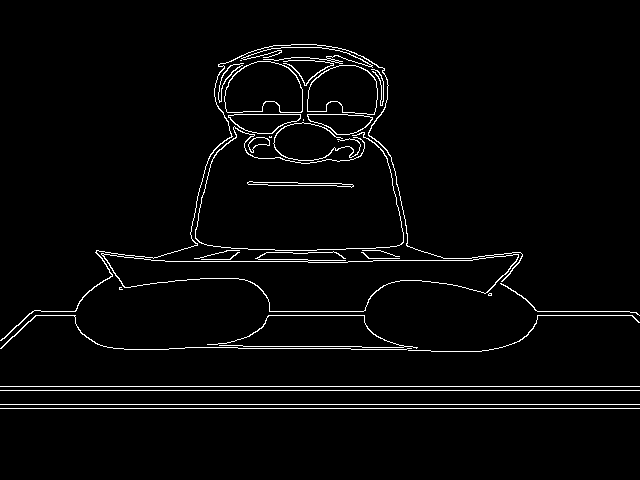

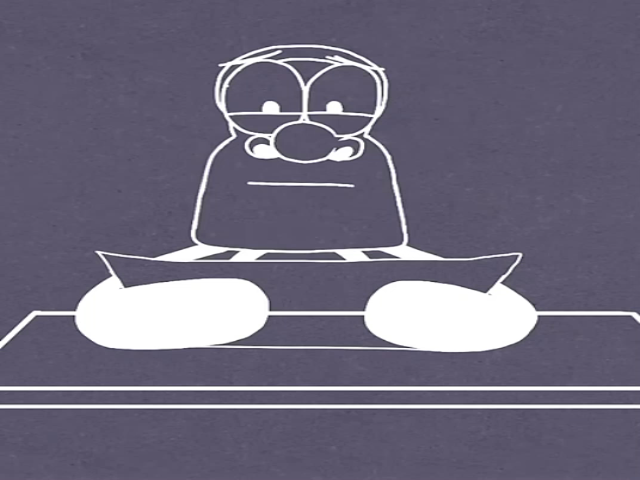

...

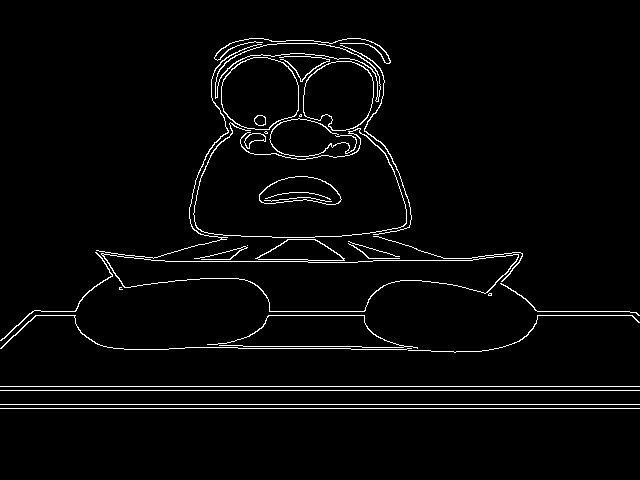

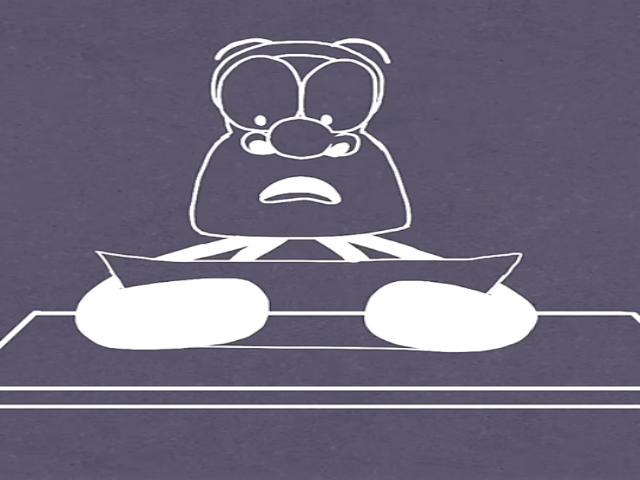

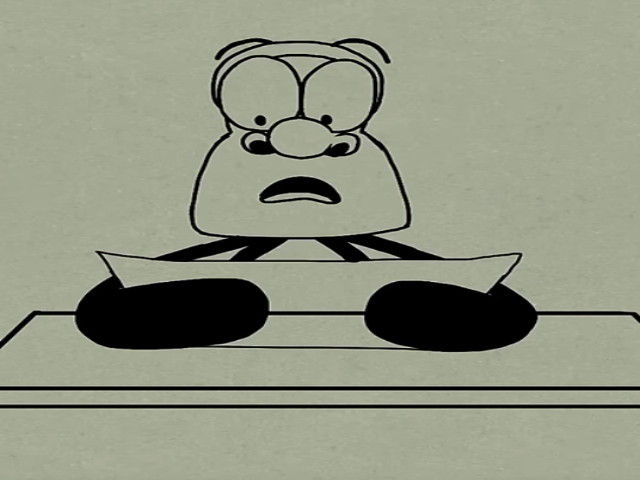

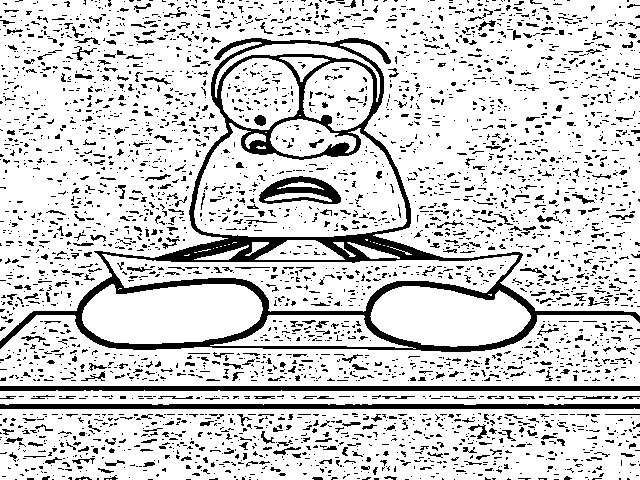

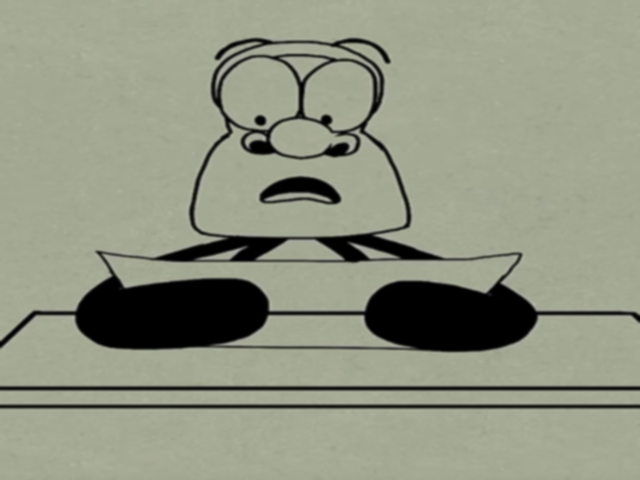

In [ ]:
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow  # For displaying images in Colab

# ==== Video path ====
video_path = '/content/Screen Recording 2025-05-02 194507.mp4'  # Replace with your video path

# ==== Create output folder ====
output_folder = 'processed_frames'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Create a VideoWriter to save the new video
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for output video
output_video = cv2.VideoWriter('output_video.mp4', fourcc, 30.0, (640, 480))  # 30 FPS, 640x480 resolution

# Open the video file
cap = cv2.VideoCapture(video_path)

# Check if video opened successfully
if not cap.isOpened():
    print("Error: Couldn't open video. Please check the video path.")
    exit()

frame_count = 0
frames_for_collage = []  # Store frames for collage

while True:
    ret, frame = cap.read()
    if not ret:
        break  # Exit loop when no frames are left

    # Resize frame (optional, to standardize size)
    frame = cv2.resize(frame, (640, 480))

    # 1. Adaptive Thresholding (Grayscale)
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

    # 2. Gaussian Smoothing
    gaussian_smooth = cv2.GaussianBlur(frame, (5, 5), 0)

    # 3. Canny Edge Detection
    canny_edges = cv2.Canny(gray, 100, 200)

    # 4. Bitwise NOT operation
    bitwise_not = cv2.bitwise_not(frame)

    # === Show each transformation (visualize each step) ===
    cv2_imshow(frame)  # Use cv2_imshow instead of cv2.imshow in Colab
    cv2_imshow(adaptive_thresh)
    cv2_imshow(gaussian_smooth)
    cv2_imshow(canny_edges)
    cv2_imshow(bitwise_not)

    # Save frames for video creation (e.g., Gaussian Smoothing)
    output_video.write(gaussian_smooth)

    # Store frames for Collage (Every 10th frame)
    if frame_count % 10 == 0:
        frames_for_collage.append(frame)

    frame_count += 1

    # Stop video by pressing 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Check if frames were collected for the collage
if len(frames_for_collage) > 0:
    # Create a collage from the selected frames
    collage = np.hstack([np.vstack(frames_for_collage[i:i+5]) for i in range(0, len(frames_for_collage), 5)])

    # Save collage image
    cv2.imwrite('collage.jpg', collage)
    print("Collage created and saved as 'collage.jpg'.")
else:
    print("No frames collected for collage.")

# Clean up and release resources
cap.release()
output_video.release()
cv2.destroyAllWindows()

print(f"Processed video frames: {frame_count}")


# **TASK-2**


In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("pevogam/ucf101")

print("Path to dataset files:", path)

In [ ]:
import shutil

# Move the extracted dataset to /content
shutil.copytree('/kaggle/input/ucf101', '/content/UCF101')


In [ ]:
import os
import cv2
import numpy as np
import random

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv3D, MaxPooling3D, GlobalAveragePooling3D, Dense


In [ ]:
# Settings
DATASET_PATH = '/content//UCF101/UCF101/UCF-101/'  # path where UCF101 extracted
selected_classes = ['Basketball', 'Typing', 'GolfSwing', 'WalkingWithDog', 'PlayingGuitar']
frames_per_video = 16
img_height, img_width = 112, 112

def load_ucf101_data(dataset_path, selected_classes, frames=16):
    X = []
    y = []

    for class_name in selected_classes:
        class_path = os.path.join(dataset_path, class_name)
        video_files = os.listdir(class_path)

        for video_file in video_files:
            video_path = os.path.join(class_path, video_file)
            frames_list = []

            cap = cv2.VideoCapture(video_path)
            total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

            if total_frames < frames:
                continue  # skip videos with too few frames

            frame_indices = np.linspace(0, total_frames-1, frames, dtype=int)

            for idx in frame_indices:
                cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
                ret, frame = cap.read()
                if ret:
                    frame = cv2.resize(frame, (img_width, img_height))
                    frame = frame / 255.0
                    frames_list.append(frame)
                else:
                    break

            cap.release()

            if len(frames_list) == frames:
                X.append(frames_list)
                y.append(class_name)

    return np.array(X), np.array(y)

# Load dataset
X, y = load_ucf101_data(DATASET_PATH, selected_classes, frames=frames_per_video)

print("Data loaded:", X.shape, y.shape)


In [ ]:
# Encode labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# One-hot encode
y_encoded = tf.keras.utils.to_categorical(y_encoded)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, stratify=y_encoded, random_state=42)

print("Train:", X_train.shape, y_train.shape)
print("Test:", X_test.shape, y_test.shape)

num_classes = len(selected_classes)


In [ ]:
# Define model
model = Sequential([
    Conv3D(32, (3,3,3), activation='relu', padding='same', input_shape=(frames_per_video, img_height, img_width, 3)),
    MaxPooling3D((2,2,2)),

    Conv3D(64, (3,3,3), activation='relu', padding='same'),
    MaxPooling3D((2,2,2)),

    Conv3D(128, (3,3,3), activation='relu', padding='same'),
    GlobalAveragePooling3D(),

    Dense(256, activation='relu'),
    Dense(num_classes, activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()


In [ ]:
# Compute class weights
class_weights = compute_class_weight('balanced', classes=np.arange(num_classes), y=np.argmax(y_train, axis=1))
class_weights = dict(enumerate(class_weights))

print("Class weights:", class_weights)


In [ ]:
# Train the model
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=15,
    batch_size=8,
    class_weight=class_weights
)


In [ ]:
# Evaluate on test set
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Predictions
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Classification report
print("\nClassification Report:")
print(classification_report(y_true_classes, y_pred_classes, target_names=label_encoder.classes_))

# Confusion matrix
print("\nConfusion Matrix:")
print(confusion_matrix(y_true_classes, y_pred_classes))
